In [18]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
import numpy as np

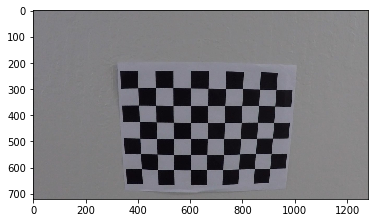

In [19]:
image = mpimg.imread('camera_cal\calibration17.jpg')
plt.imshow(image)

In [20]:
#there are 9 corner points in a row and 6 corner points in a column
#First step - performing camera clibration in this section

import glob
row_corner_points  =  9
column_corner_points  =  6

shape  = image.shape
objpoints  = []
imgpoints = []

objp = np.zeros((row_corner_points*column_corner_points,3), np.float32)
objp[:,:2] = np.mgrid[0:row_corner_points,0:column_corner_points].T.reshape(-1,2)

image_names = glob.glob("camera_cal/calibration*.jpg")

for image_name in image_names:
    img = mpimg.imread(image_name)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (row_corner_points, column_corner_points), None)
    if ret:
        objpoints.append(objp)
        imgpoints.append(corners)
        
# Using the object and image points compute the camera matrix and distortion coefficients
ret, cameraMatrix, distortionCoeffs, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, shape[:2],None,None)

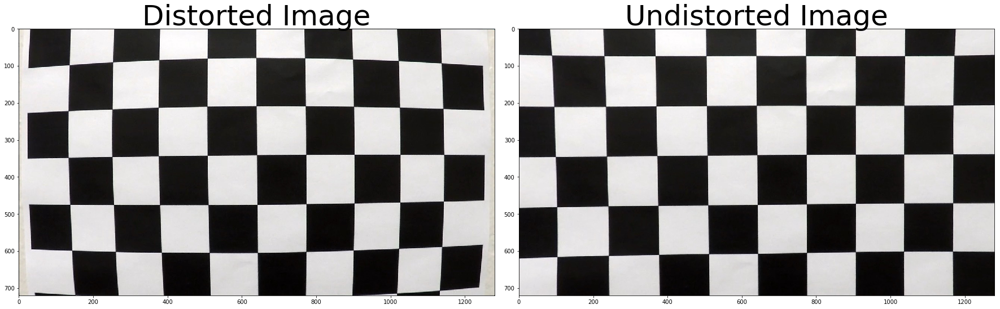

In [21]:
#select a distorted image and undistort it using distortion cofficients and calibration matrix
#Second step - undistortion
img = mpimg.imread('camera_cal/calibration1.jpg')
undistorted = cv2.undistort(img, cameraMatrix, distortionCoeffs, None, cameraMatrix)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Distorted Image', fontsize=50)
ax2.imshow(undistorted)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [22]:
#function to calculate abosolute sobel threshold
def absolute_sobel_thresh(image, orient='x', kernel_size=3, thresh=(0, 255)):
    if orient == 'x':
        sobel = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=kernel_size)
    elif orient == 'y':
        sobel = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=kernel_size)
    # Take the absolute values
    sobel = np.absolute(sobel)
    # Rescale back to 8 bit integer
    scaled_sobel_values = np.uint8(255*sobel/np.max(sobel))
    # Filter using threshold
    binary_img = np.zeros_like(scaled_sobel_values)
    binary_img[(scaled_sobel_values > thresh[0]) & (scaled_sobel_values < thresh[1])] = 1
    return binary_img

#function to calculate maginitude sobel threshold i.e, sqrt(x^2 + y^2)
def magnitude_sobel_thresh(image, kernel_size=3, thresh=(0, 255)):
    sobelx = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=kernel_size)
    sobely = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=kernel_size)    
    # Take the magnitude
    sobel = np.sqrt(sobelx ** 2 + sobely ** 2) 
    # Rescale back to 8 bit integer
    scaled_sobel_values = np.uint8(255*sobel/np.max(sobel))
    # Filter using threshold
    binary_img = np.zeros_like(scaled_sobel_values)
    binary_img[(scaled_sobel_values > thresh[0]) & (scaled_sobel_values < thresh[1])] = 1
    return binary_img

#function to calculate direction sobel threshold
def direction_sobel_threshold(image, kernel_size = 3, thresh=(0,255)):
    sobelx = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=kernel_size)
    sobely = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=kernel_size) 
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_img =  np.zeros_like(absgraddir)
    binary_img[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1
    return binary_img

#function to return s channel
def get_s_channel(image):
    img_hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    return img_hls[:,:,2]

#function to perfrom region mamsking
def get_region_of_interest(image, vertices):
    mask = np.zeros_like(image)       
    cv2.fillPoly(mask, vertices, 255)
    masked_image = cv2.bitwise_and(image, mask)
    return masked_image

In [23]:
#create a pipeline to obtain binary gradient in the region of interest
def get_thresholded(image):     
    kernel_size = 5
    # Perform Gaussian Blur to remove noise
    image = cv2.GaussianBlur(image, (kernel_size, kernel_size), 0)
    image = cv2.undistort(image, cameraMatrix, distortionCoeffs, None, cameraMatrix)
    # Convert to HLS color space and separate the S channel
    s = get_s_channel(image)
    # Grayscale image
    gray_image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    # sobel kernel size
    ksize = 7
    # Apply each of the thresholding functions
    abs_gradx = absolute_sobel_thresh(gray_image, orient='x', kernel_size=ksize, thresh=(10, 255))
    abs_grady = absolute_sobel_thresh(gray_image, orient='y', kernel_size=ksize, thresh=(60, 255))
    mag_grad = magnitude_sobel_thresh(gray_image, kernel_size=ksize, thresh=(40, 255))
    dir_grad = direction_sobel_threshold(gray_image, kernel_size=ksize, thresh=(.65, 1.05))
    # Combine all the thresholding information
    combined = np.zeros_like(dir_grad)
    combined[((abs_gradx == 1) & (abs_grady == 1)) | ((mag_grad == 1) & (dir_grad == 1))] = 1
    # Threshold color channel
    s_binary = np.zeros_like(combined)
    s_binary[(s > 160) & (s < 255)] = 1
    # Stack each channel to view their individual contributions in green and blue respectively
    # This returns a stack of the two binary images, whose components you can see as different colors    
    color_binary = np.zeros_like(combined)
    color_binary[(s_binary > 0) | (combined > 0)] = 1
    # Defining vertices for marked area
    imshape = image.shape
    left_bottom = (100, imshape[0])
    right_bottom = (imshape[1]-20, imshape[0])
    apex1 = (610, 410)
    apex2 = (680, 410)
    inner_left_bottom = (310, imshape[0])
    inner_right_bottom = (1150, imshape[0])
    inner_apex1 = (700,480)
    inner_apex2 = (650,480)
    #vertices = np.array([[left_bottom, apex1, apex2, \
    #                      right_bottom, inner_right_bottom, \
    #                      inner_apex1, inner_apex2, inner_left_bottom]], dtype=np.int32)
    
    vertices = np.array([[left_bottom, apex1, apex2, \
                          right_bottom]], dtype=np.int32)
    
    # Masked area
    color_binary = get_region_of_interest(color_binary, vertices)
    return color_binary

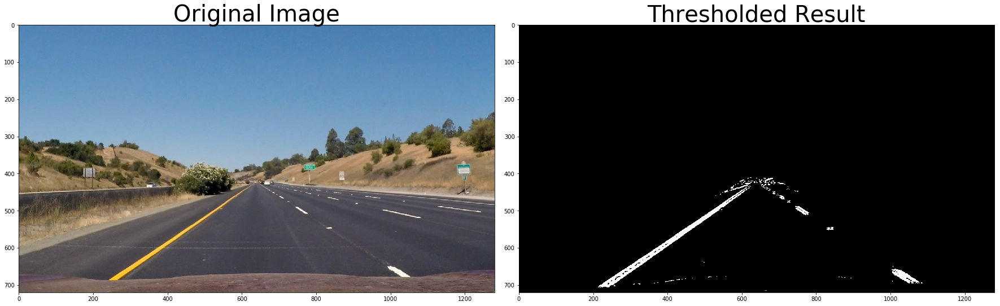

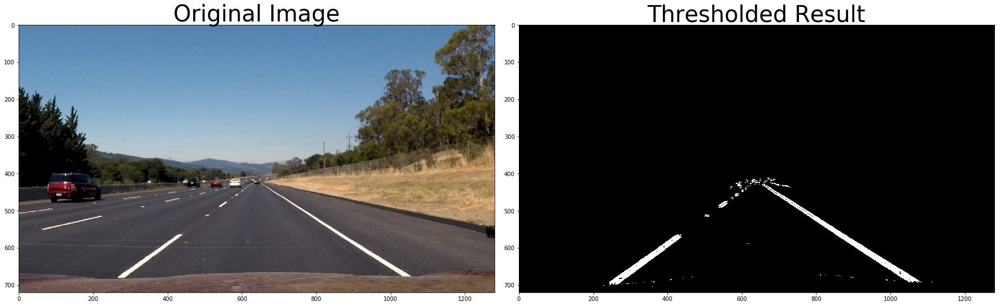

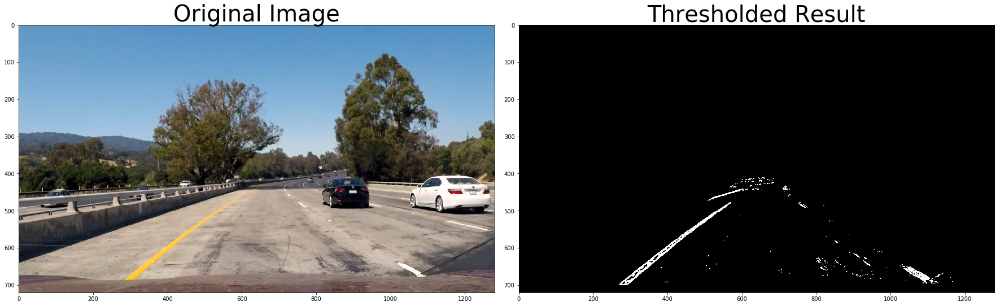

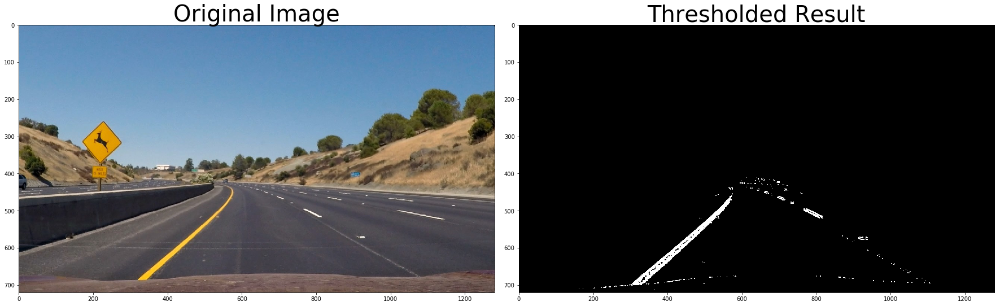

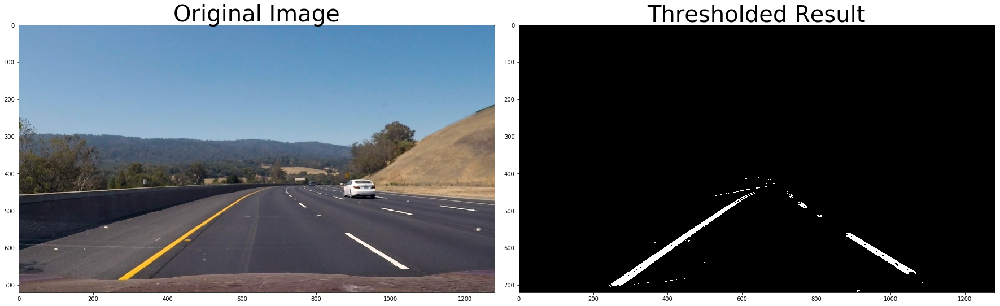

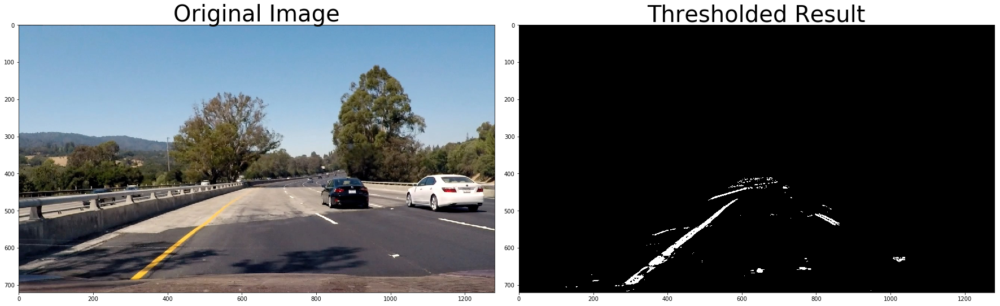

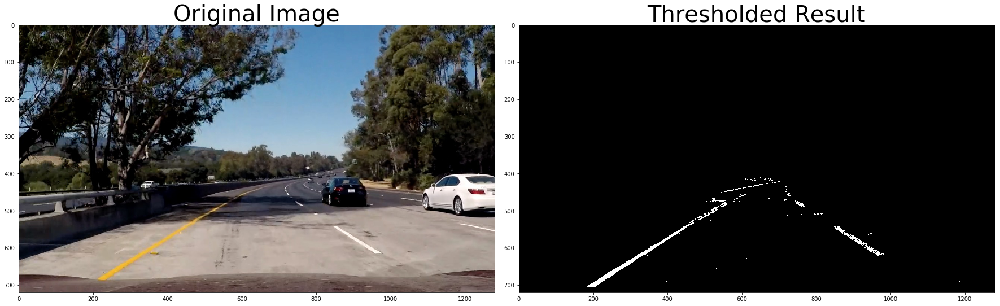

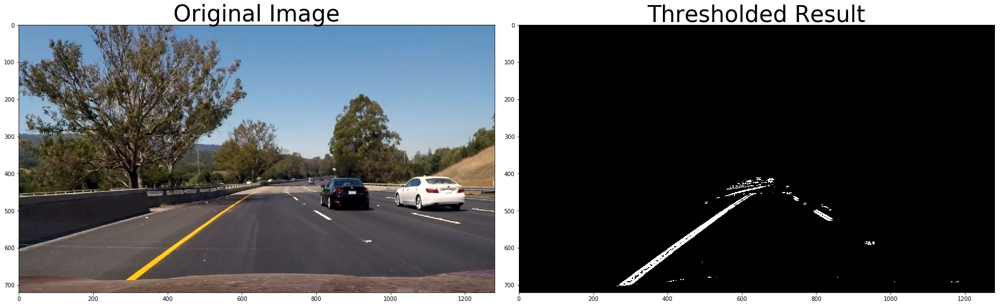

In [24]:
#test_img = 'test_images\straight_lines1.jpg'
image_names = glob.glob("test_images/*.jpg")
for image_name in image_names:
    image = mpimg.imread(image_name)
    result = get_thresholded(image)

    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=40)

    ax2.imshow(result, cmap='gray')
    ax2.set_title('Thresholded Result', fontsize=40)

    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

image shape: (720, 1280, 3)
birds eye view - perspective transform 


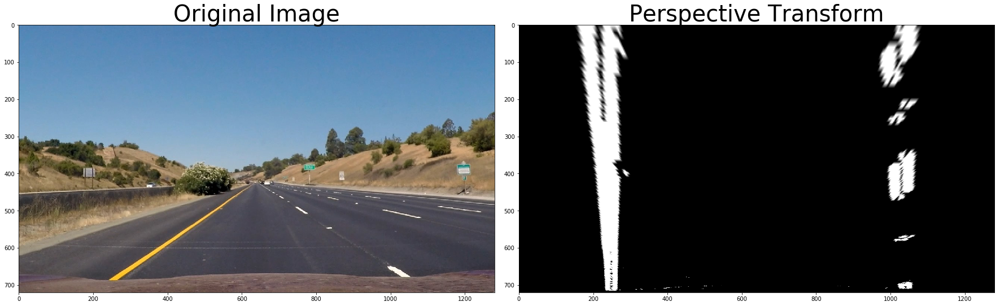

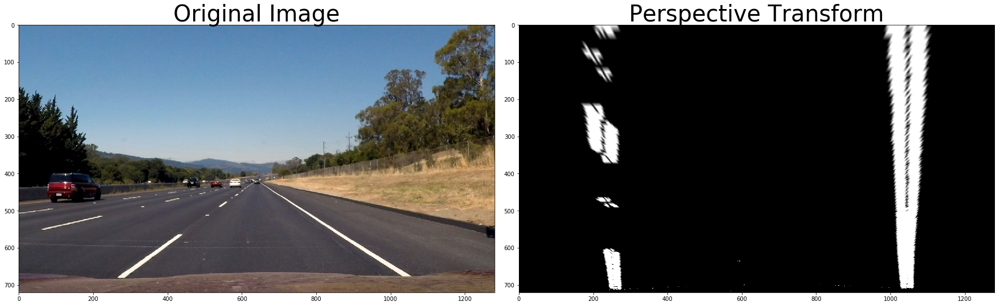

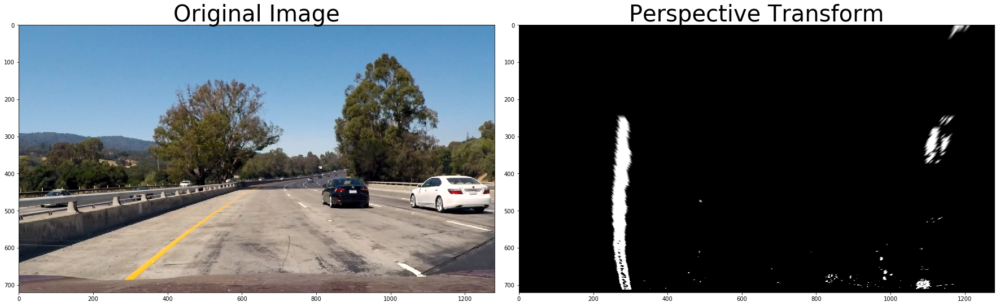

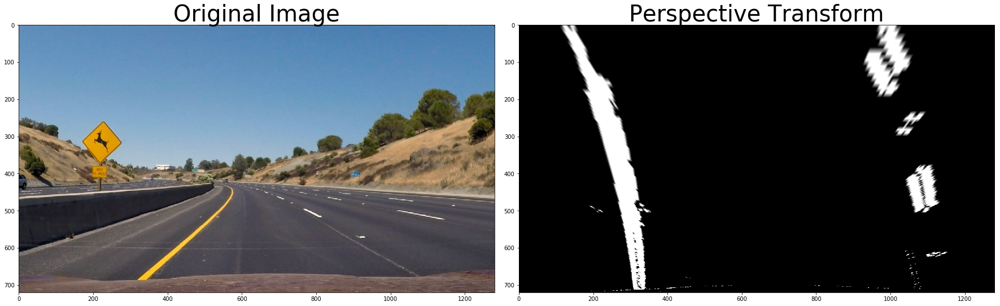

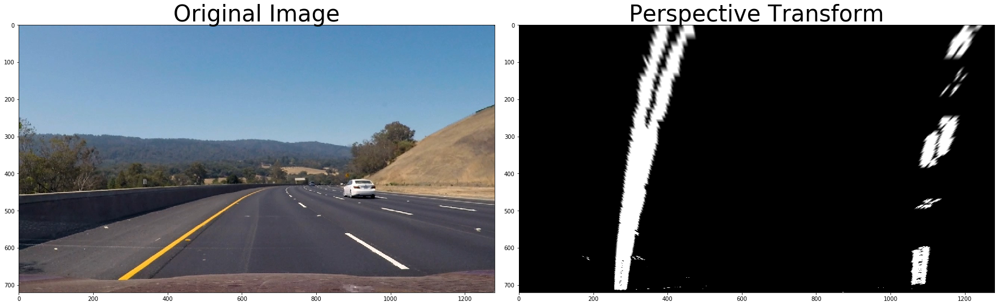

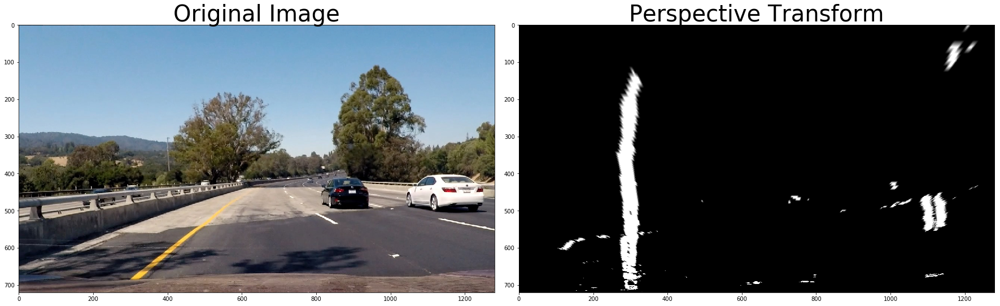

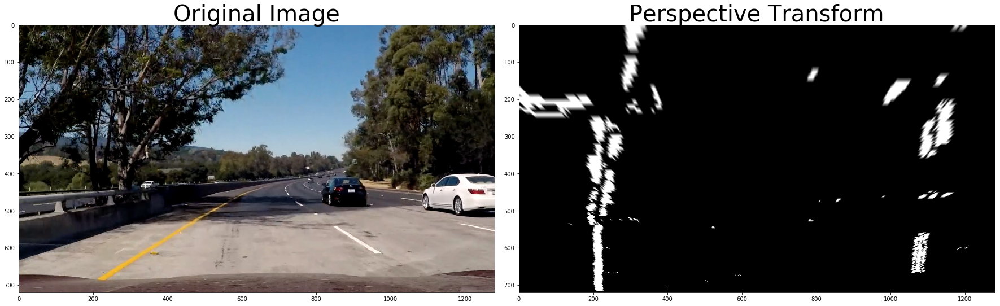

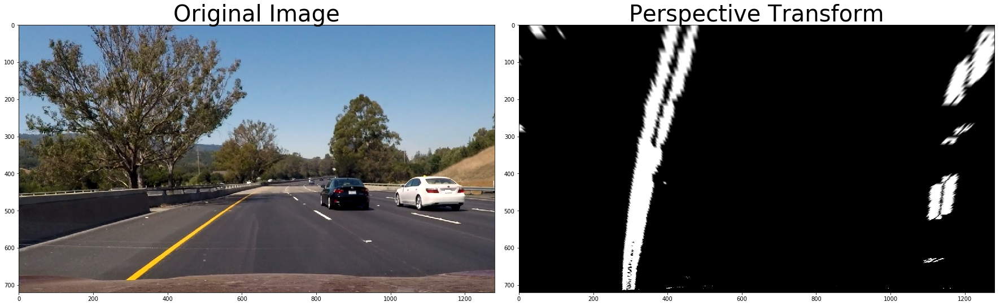

In [25]:
# perform perspective transform and get warp image
# Define image shape
image_shape = image.shape
print("image shape:",image_shape)

# Define the src points for perspective transform region
area_of_interest = [[150+430,460],[1150-440,460],[1150,720],[150,720]]

# Define a function that takes an image, number of x and y points, 
# camera matrix and distortion coefficients
def warp(image):
    offset1 = 200 
    offset2 = 0 
    img_size = (image.shape[1], image.shape[0])
    # Transform source points into np array
    src = np.float32(area_of_interest)
    # choose arbitary destination points
    dst = np.float32([[offset1, offset2], 
                      [img_size[0]-offset1, offset2], 
                      [img_size[0]-offset1, img_size[1]-offset2], 
                      [offset1, img_size[1]-offset2]])
    # Get the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    # Get the inverse perspective matrix 
    Minv = cv2.getPerspectiveTransform(dst, src)
    # Get the warp image 
    warped = cv2.warpPerspective(image, M, img_size)
    # Return the resulting warp image and perception matrix
    return warped, M, Minv
print("birds eye view - perspective transform ")
image_names = glob.glob("test_images/*.jpg")
for image_name in image_names:
    image = mpimg.imread(image_name)
    result = get_thresholded(image)
    perspective_img, matrix, inverse_matrix = corners_unwarp(result, row_corner_points, column_corner_points, cameraMatrix, distortionCoeffs)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=40)
    ax2.imshow(perspective_img, cmap='gray')
    ax2.set_title('Perspective Transform', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    


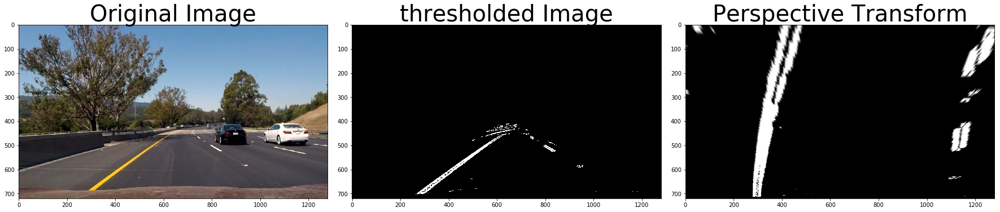

In [27]:
result = get_thresholded(image)
binary_warped, p_M, p_Minv = warp(result)
f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image, cmap='gray')
ax1.set_title('Original Image', fontsize=40)
ax2.imshow(result, cmap='gray')
ax2.set_title('thresholded Image', fontsize = 40)
ax3.imshow(binary_warped, cmap='gray')
ax3.set_title('Perspective Transform', fontsize=40)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [39]:
def get_lanes_plot(binary_warped):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    yvals = np.linspace(0, 100, num=101)*7.2  # to cover same y-range as image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
        (0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
        (0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    #to find radius of curvature
    left_curve = left_fit[0]*yvals**2 + left_fit[1]*yvals + left_fit[2]
    right_curve = right_fit[0]*yvals**2 + right_fit[1]*yvals + right_fit[2]
    left_curve_radius = find_curve_radius(yvals, left_curve)
    right_curve_radius = find_curve_radius(yvals, right_curve)
    curve_radius = (left_curve_radius + right_curve_radius)/2
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    '''out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    plt.imshow(out_img)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)'''

    return left_fitx, right_fitx, ploty,curve_radius
    
def find_curve_radius(ploty, fit_x):
    y_eval = np.max(ploty)
    ym = 30/720 #pixel to meters
    xm = 3.7/700 #pixel to meters
    curve = np.polyfit(ploty*ym, fit_x*xm, 2)
    curve_radius = ((1 + (2*curve[0]*y_eval + curve[1])**2)**1.5) /np.absolute(2*curve[0])
    return curve_radius

def find_center_position(pts,image):
    shape = image.shape
    actual_position = shape[1]/2
    left  = np.min(pts[(pts[:,1] < actual_position) & (pts[:,0] > 700)][:,1])
    right = np.max(pts[(pts[:,1] > actual_position) & (pts[:,0] > 700)][:,1])
    center = (left + right)/2
    xm = 3.7/700 # pixel to meter conversion
    return (actual_position - center)*xm
    

def draw_lanes(left_fitx, right_fitx, ploty, warped, undist, Minv, curve_radius):
    # Create an image to draw the lines on
    warped = np.copy(binary_warped)
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (undist.shape[1], undist.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    pts = np.argwhere(newwarp[:,:,1])
    font = cv2.FONT_HERSHEY_SIMPLEX
    position = find_center_position(pts, result)
    if(position < 0):
        position*=-1
    text = "Distance from center: {:.2f} m".format(position)
    cv2.putText(result,text,(100,300), font, 1,(255,0,0),2)
    text = "curve radius: {} m".format(int(curve_radius))
    cv2.putText(result,text,(100,350), font, 1,(255,0,0),2)
    return result

In [40]:
left_lane, right_lane, ploty, curve_radius = get_lanes_plot(binary_warped)
undist = cv2.undistort(image, cameraMatrix, distortionCoeffs, None, cameraMatrix)

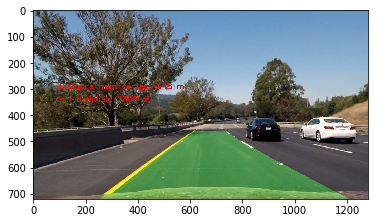

In [30]:
final_image = draw_lanes(left_lane, right_lane, ploty, binary_warped, undist, p_Minv, curve_radius)
plt.imshow(final_image)

In [31]:
def process_image(image):
    undist = cv2.undistort(image, cameraMatrix, distortionCoeffs, None, cameraMatrix)
    result = get_thresholded(image)
    perspective_img, matrix, inverse_matrix = warp(result)
    left_lane, right_lane, ploty, curve_radius = get_lanes_plot(perspective_img)
    final_image = draw_lanes(left_lane, right_lane, ploty, perspective_img, undist, inverse_matrix, curve_radius)
    return final_image

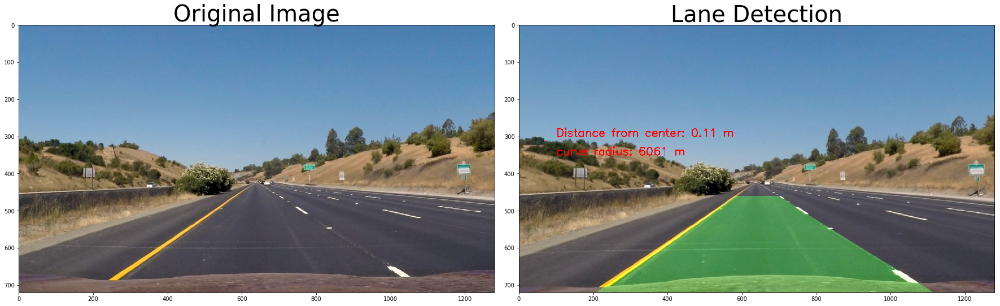

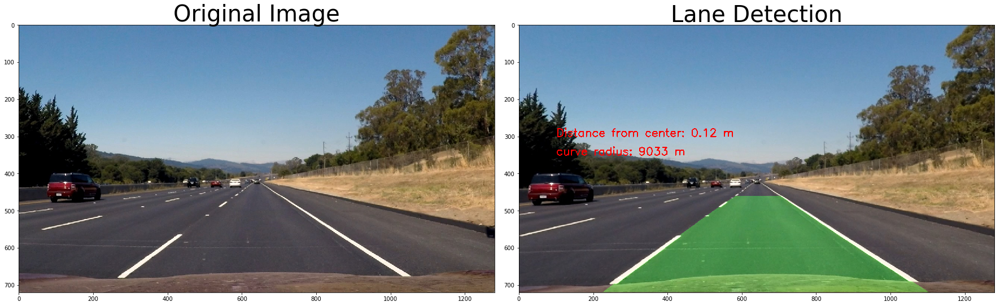

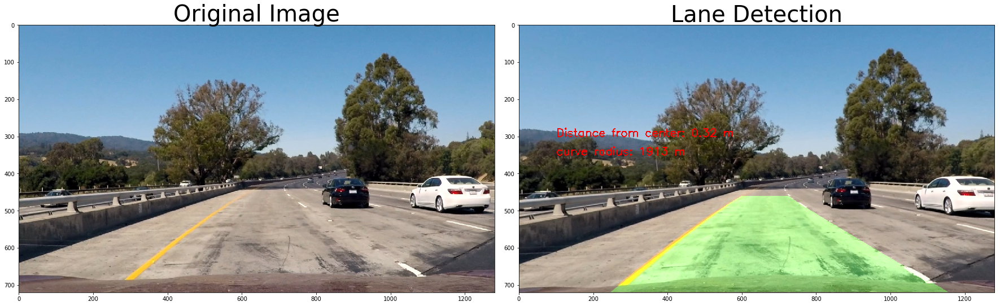

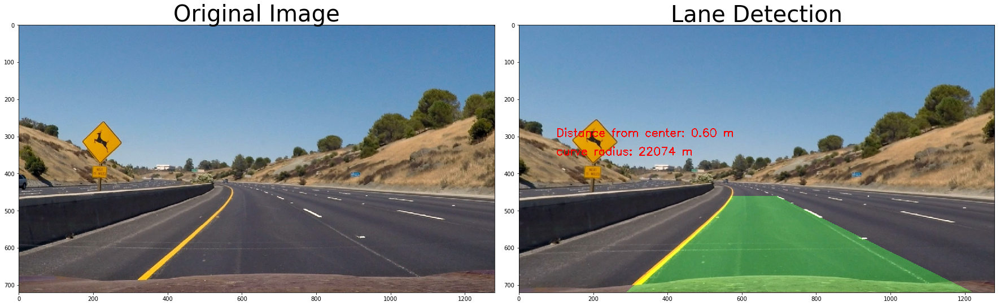

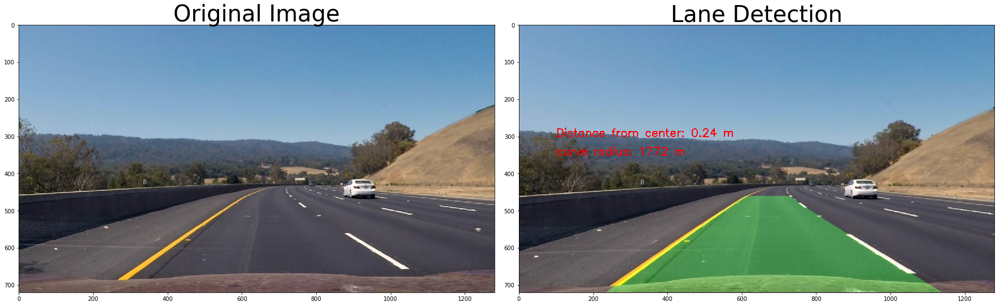

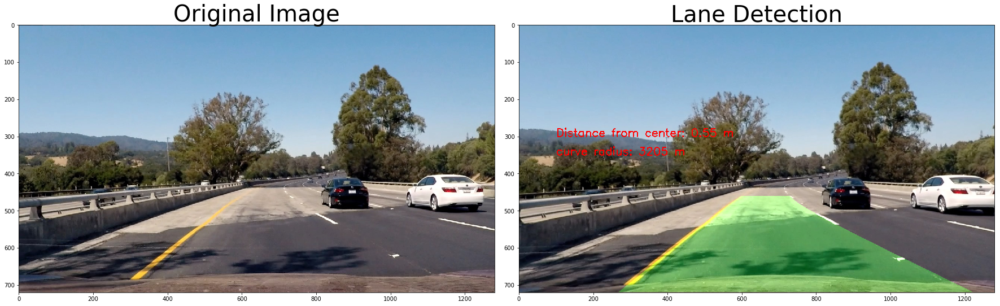

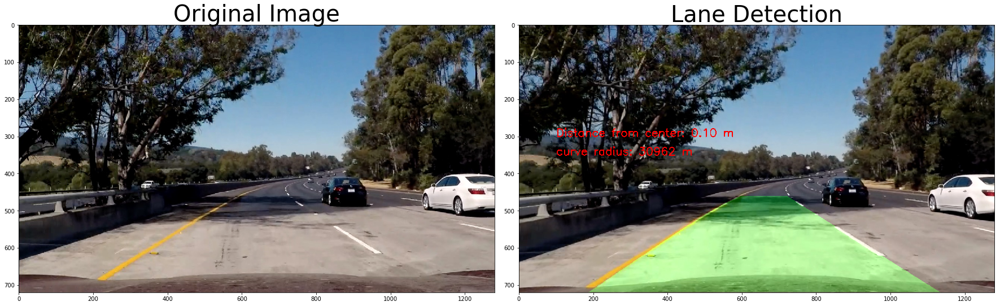

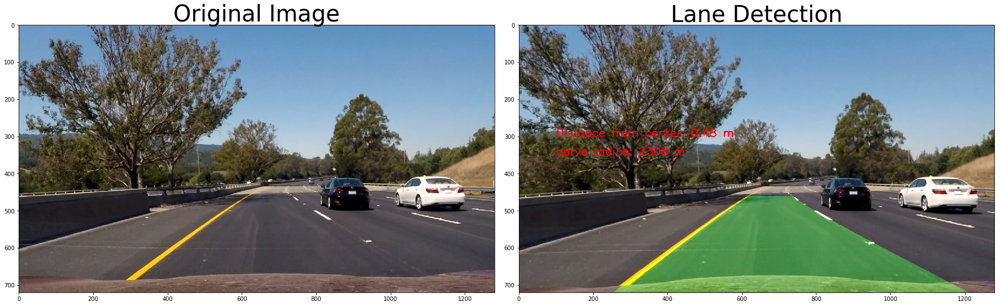

In [36]:
image_names = glob.glob("test_images/*.jpg")
for image_name in image_names:
    image = mpimg.imread(image_name)
    final_image = process_image(image)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=40)
    ax2.imshow(final_image, cmap='gray')
    ax2.set_title('Lane Detection', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [33]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [34]:
white_output = 'test_videos/project_video.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

[MoviePy] >>>> Building video test_videos/project_video.mp4
[MoviePy] Writing video test_videos/project_video.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1260/1261 [09:19<00:00,  2.25it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos/project_video.mp4 

Wall time: 9min 21s


In [17]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(white_output))